firstly initializing the gemini api key 

In [3]:
import google.generativeai as genai

genai.configure(api_key=os.environ["GEMINI_API_KEY"])

models = genai.list_models()
for model in models:
    print(model.name)

models/chat-bison-001
models/text-bison-001
models/embedding-gecko-001
models/gemini-1.0-pro-vision-latest
models/gemini-pro-vision
models/gemini-1.5-pro-latest
models/gemini-1.5-pro-001
models/gemini-1.5-pro-002
models/gemini-1.5-pro
models/gemini-1.5-flash-latest
models/gemini-1.5-flash-001
models/gemini-1.5-flash-001-tuning
models/gemini-1.5-flash
models/gemini-1.5-flash-002
models/gemini-1.5-flash-8b
models/gemini-1.5-flash-8b-001
models/gemini-1.5-flash-8b-latest
models/gemini-1.5-flash-8b-exp-0827
models/gemini-1.5-flash-8b-exp-0924
models/gemini-2.0-flash-exp
models/gemini-2.0-flash
models/gemini-2.0-flash-001
models/gemini-2.0-flash-lite-001
models/gemini-2.0-flash-lite
models/gemini-2.0-flash-lite-preview-02-05
models/gemini-2.0-flash-lite-preview
models/gemini-2.0-pro-exp
models/gemini-2.0-pro-exp-02-05
models/gemini-exp-1206
models/gemini-2.0-flash-thinking-exp-01-21
models/gemini-2.0-flash-thinking-exp
models/gemini-2.0-flash-thinking-exp-1219
models/learnlm-1.5-pro-experim

In [2]:
import google.generativeai as genai
import pandas as pd
from dotenv import load_dotenv
import os

# Load environment variables from .env file
load_dotenv()

# Configure the API key
genai.configure(api_key=os.environ["GEMINI_API_KEY"])

# Initialize the model (use a valid model name like 'gemini-pro')
model = genai.GenerativeModel('gemini-2.0-flash')

# Generate content
response = model.generate_content("The opposite of hot is")

# Print the generated text
print(response.text)

cold.



Found 235 PNG images.


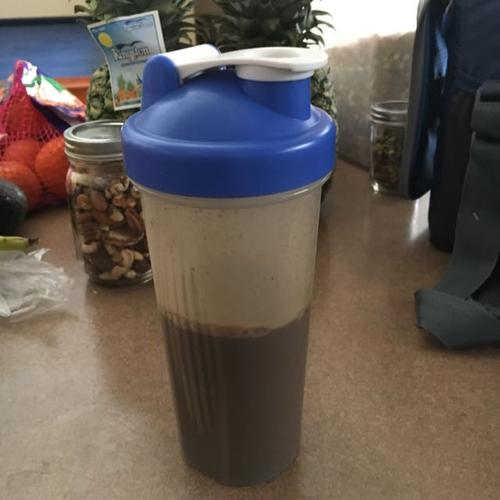

Displayed: /Users/tanishqsingh/Desktop/yolovfaces/images/image_15.png


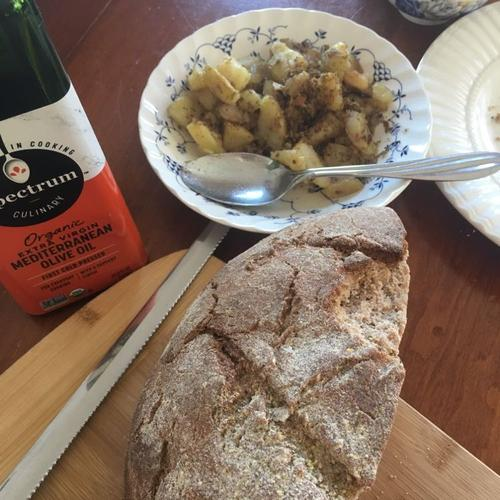

Displayed: /Users/tanishqsingh/Desktop/yolovfaces/images/image_29.png


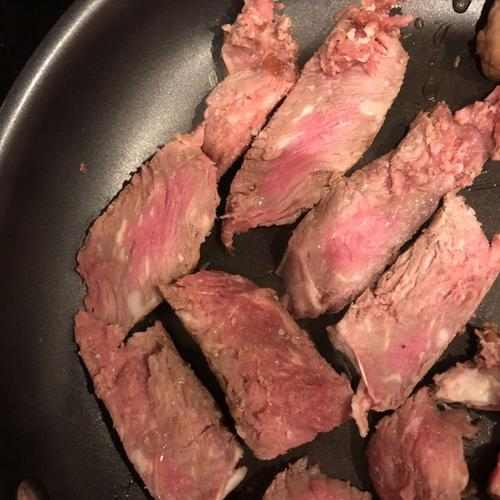

Displayed: /Users/tanishqsingh/Desktop/yolovfaces/images/image_178.png


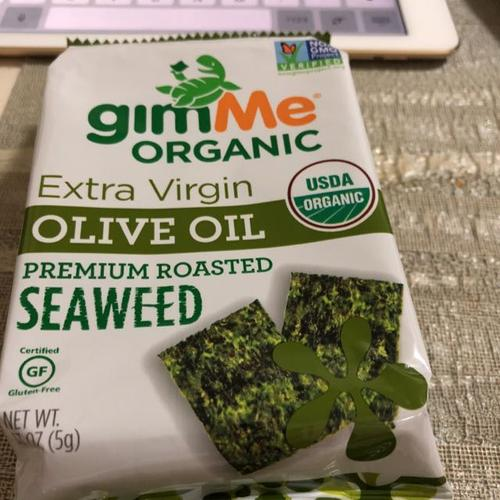

Displayed: /Users/tanishqsingh/Desktop/yolovfaces/images/image_144.png


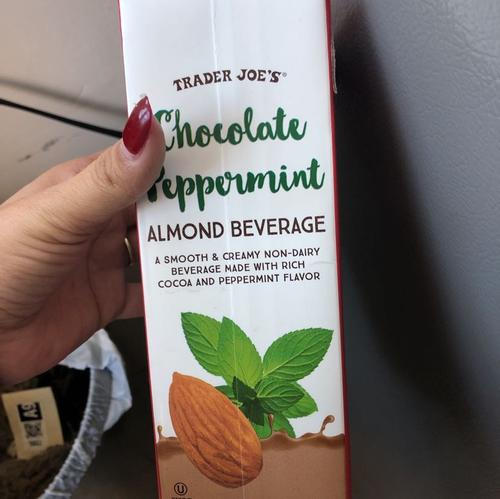

Displayed: /Users/tanishqsingh/Desktop/yolovfaces/images/image_150.png


In [4]:
from PIL import Image
from IPython.display import display
data_directory = "/Users/tanishqsingh/Desktop/yolovfaces/images"
png_files = [os.path.join(data_directory, file) for file in os.listdir(data_directory) if file.endswith('.png')]
print(f"Found {len(png_files)} PNG images.")
for image_path in png_files[:5]: 
    image = Image.open(image_path)
    display(image)
    print(f"Displayed: {image_path}")

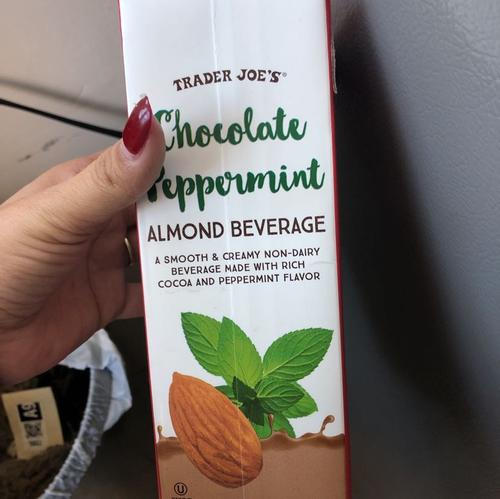

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_150.png
Dimensions (W x H): (500, 499)
Resolution (DPI): N/A
File Size: 253.22 KB


In [5]:
def display_image_details(image_path):
    image = Image.open(image_path)
    dimensions = image.size 
    resolution = image.info.get('dpi', 'N/A') 
    file_size = os.path.getsize(image_path) / 1024
    display(image)
    print(f"File Path: {image_path}")
    print(f"Dimensions (W x H): {dimensions}")
    print(f"Resolution (DPI): {resolution}")
    print(f"File Size: {file_size:.2f} KB")
def resize_image(image, max_dimension=500):
    width, height = image.size
    if width > height:
        new_width = max_dimension
        new_height = int((max_dimension / width) * height)
    else:
        new_height = max_dimension
        new_width = int((max_dimension / height) * width)
    return image.resize((new_width, new_height), Image.LANCZOS)
def downsize_image(image, max_dimension=1000):
    width, height = image.size
    if width > max_dimension or height > max_dimension:
        if width > height:
            new_width = max_dimension
            new_height = int((max_dimension / width) * height)
        else:
            new_height = max_dimension
            new_width = int((max_dimension / height) * width)
        return image.resize((new_width, new_height), Image.LANCZOS)
    else:
        return image
image_path = png_files[4] 
image = Image.open(image_path)
image = downsize_image(image, max_dimension=1000)
dimensions = image.size 
resolution = image.info.get('dpi', 'N/A') 
file_size = os.path.getsize(image_path) / 1024 
display(image)
print(f"File Path: {image_path}")
print(f"Dimensions (W x H): {dimensions}")
print(f"Resolution (DPI): {resolution}")
print(f"File Size: {file_size:.2f} KB")

Parsed JSON Response: [{'name': "Trader Joe's Chocolate Peppermint Almond Beverage", 'grams': 946, 'bounding_box': [0, 0, 666, 999]}]
Bounding Box for Trader Joe's Chocolate Peppermint Almond Beverage: (0, 0) to (499, 498)


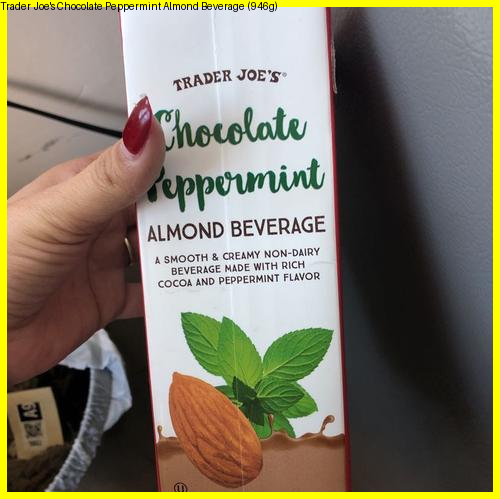

In [6]:
import base64
import google.generativeai as genai
from io import BytesIO
from PIL import Image, ImageDraw, ImageFont
def encode_image(image):
    buffered = BytesIO()
    image.save(buffered, format="PNG")
    return base64.b64encode(buffered.getvalue()).decode('utf-8')
image_path = png_files[4]
image = Image.open(image_path)
base64_image = encode_image(image)
contents = [
    {
        "parts": [
            {"text": "Identify the foods or drinks in the image. Estimate the amount in grams. "
                     "Additionally, generate bounding boxes for each item. "
                     "Respond only in JSON format with fields 'name', 'grams', and 'bounding_box' "
                     "(as a list of [x_min, y_min, x_max, y_max] in pixels or normalized between 0-1)."},
            {"inline_data": {"mime_type": "image/png", "data": base64_image}}
        ]
    }
]
response = genai.GenerativeModel(model_name="gemini-1.5-flash").generate_content(contents=contents)
import json
try:
    response_text = response.text.strip("```json").strip("```").strip()
    food_data = json.loads(response_text) 
    print("Parsed JSON Response:", food_data)
except json.JSONDecodeError:
    print("Error parsing response as JSON:", response.text)
    food_data = []
def scale_bounding_boxes(food_data, image_width, image_height):
    for item in food_data:
        if "bounding_box" in item and isinstance(item["bounding_box"], list):
            bbox = item["bounding_box"]
            if all(0 <= coord <= 1 for coord in bbox):  
                x_min = int(bbox[0] * image_width)
                y_min = int(bbox[1] * image_height)
                x_max = int(bbox[2] * image_width)
                y_max = int(bbox[3] * image_height)
                item["bounding_box"] = [x_min, y_min, x_max, y_max] 
    return food_data

food_data = scale_bounding_boxes(food_data, image.width, image.height)
def draw_bounding_boxes(image, food_data):
    draw = ImageDraw.Draw(image)
    width, height = image.size

    for item in food_data:
        if "bounding_box" in item and isinstance(item["bounding_box"], list):
            bbox = item["bounding_box"]
            if len(bbox) == 4:
                x_min, y_min, x_max, y_max = bbox
                x_min, y_min = max(0, x_min), max(0, y_min)
                x_max, y_max = min(width - 1, x_max), min(height - 1, y_max)
                print(f"Bounding Box for {item['name']}: ({x_min}, {y_min}) to ({x_max}, {y_max})")
                box_color = "yellow"  
                box_thickness = 7  
                draw.rectangle([(x_min, y_min), (x_max, y_max)], outline=box_color, width=box_thickness)
                label = f"{item['name']} ({item['grams']}g)"
                text_position = (x_min, max(y_min - 20, 0))
                draw.text(text_position, label, fill="black")

    return image
annotated_image = draw_bounding_boxes(image.copy(), food_data)
display(annotated_image)

In [7]:
import json
def get_content_json(response):
    try:
        response_text = response.text.strip("```json").strip("```").strip()
        parsed_data = json.loads(response_text)
        
        return parsed_data
    except (json.JSONDecodeError, KeyError) as e:
        print(f"Error parsing JSON response: {e}")
        return None
parsed_response = get_content_json(response)
print(parsed_response)

[{'name': "Trader Joe's Chocolate Peppermint Almond Beverage", 'grams': 946, 'bounding_box': [0, 0, 666, 999]}]


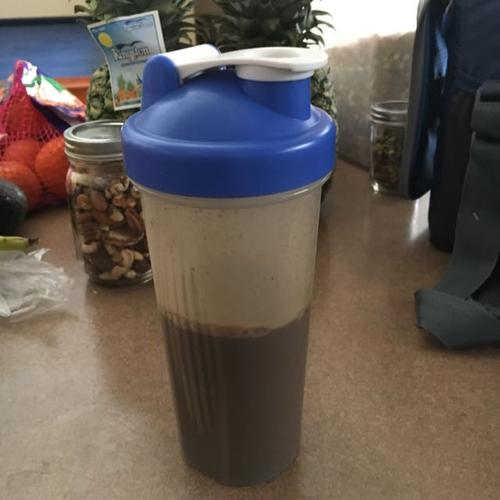

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_15.png
Dimensions (W x H): (500, 500)
Resolution (DPI): N/A
File Size: 231.07 KB


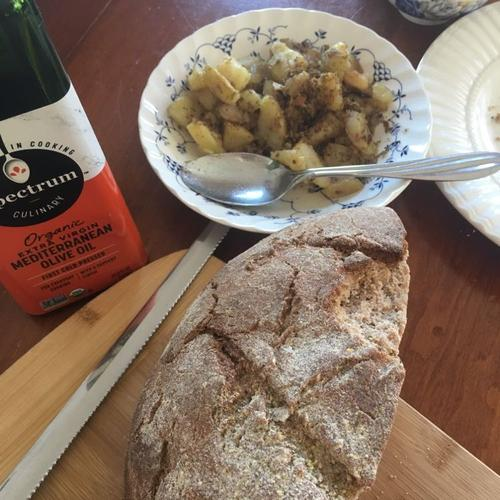

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_29.png
Dimensions (W x H): (500, 500)
Resolution (DPI): N/A
File Size: 413.23 KB


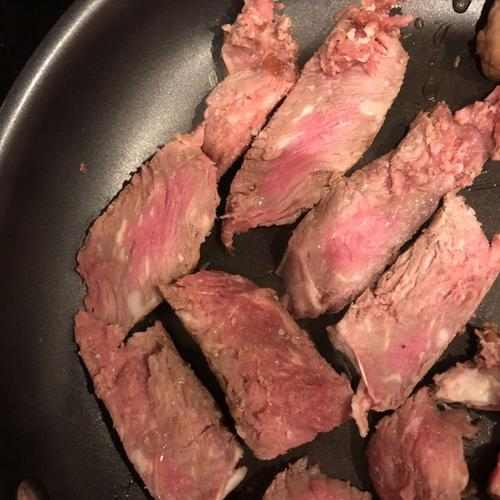

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_178.png
Dimensions (W x H): (500, 500)
Resolution (DPI): N/A
File Size: 374.53 KB


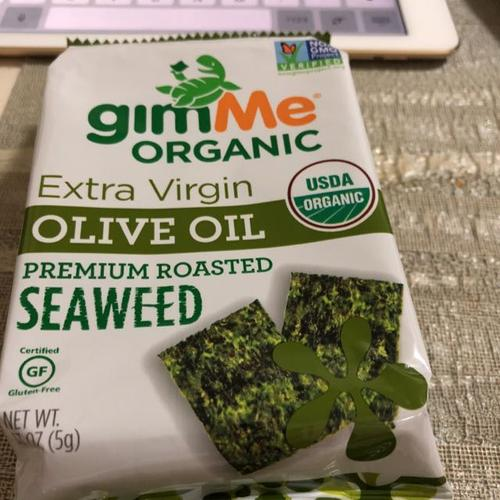

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_144.png
Dimensions (W x H): (500, 500)
Resolution (DPI): N/A
File Size: 352.35 KB


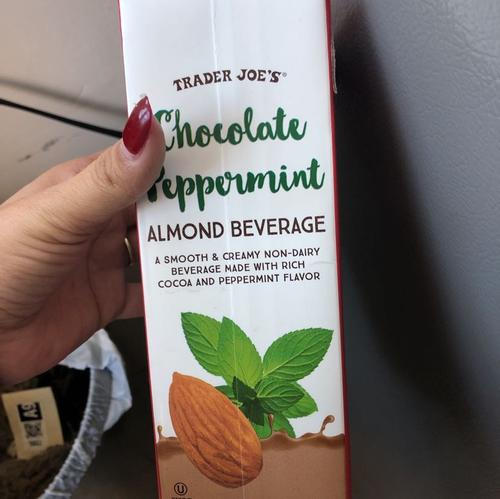

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_150.png
Dimensions (W x H): (500, 499)
Resolution (DPI): N/A
File Size: 253.22 KB


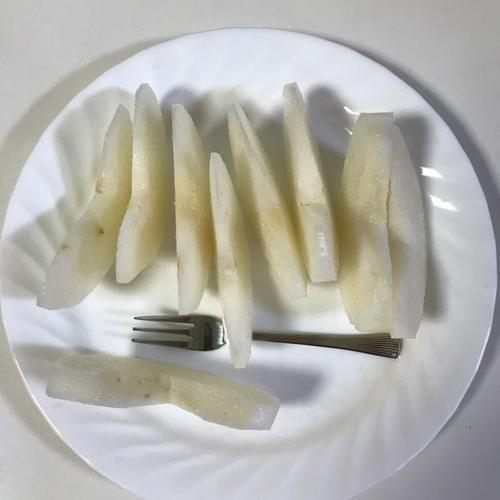

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_187.png
Dimensions (W x H): (500, 500)
Resolution (DPI): N/A
File Size: 204.19 KB


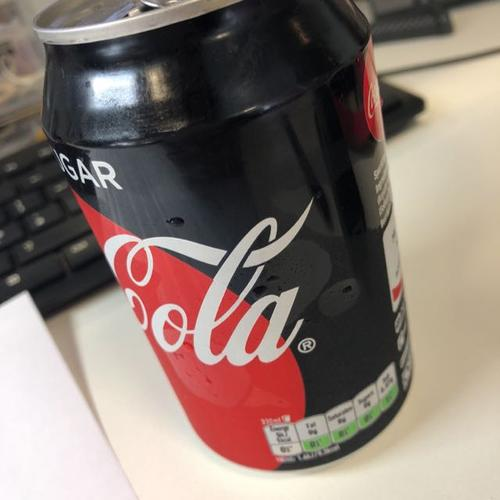

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_193.png
Dimensions (W x H): (500, 500)
Resolution (DPI): N/A
File Size: 231.16 KB


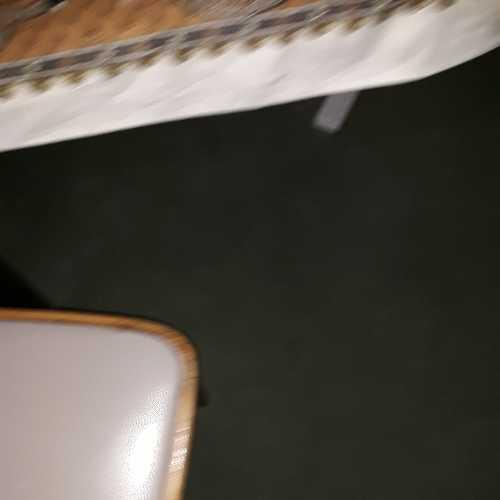

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_226.png
Dimensions (W x H): (500, 500)
Resolution (DPI): N/A
File Size: 84.53 KB


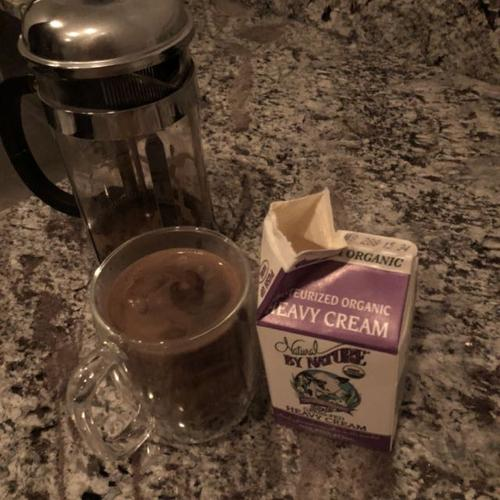

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_192.png
Dimensions (W x H): (500, 500)
Resolution (DPI): N/A
File Size: 370.07 KB


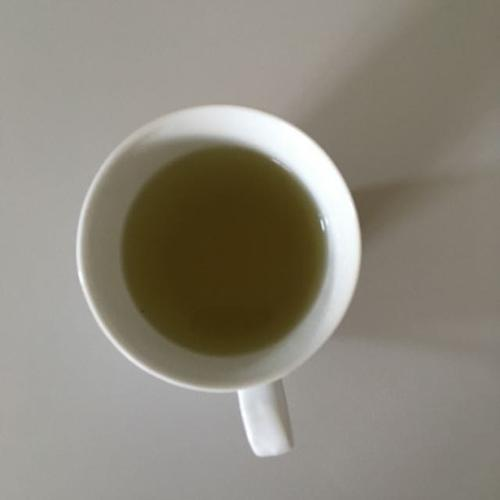

File Path: /Users/tanishqsingh/Desktop/yolovfaces/images/image_186.png
Dimensions (W x H): (500, 500)
Resolution (DPI): N/A
File Size: 76.47 KB


In [8]:
for i in range(min(10, len(png_files))):  
    image_path = png_files[i]  
    display_image_details(image_path)  

In [9]:
import os
import base64
import pandas as pd
from io import BytesIO
from PIL import Image

def resize_image(image, max_dimension=500):
    width, height = image.size
    if width > height:
        new_width = max_dimension
        new_height = int((max_dimension / width) * height)
    else:
        new_height = max_dimension
        new_width = int((max_dimension / height) * width)
    return image.resize((new_width, new_height), Image.LANCZOS)
def encode_image(image):
    buffered = BytesIO()
    image.save(buffered, format="PNG")  
    buffer_value = buffered.getvalue()
    encoded_image = base64.b64encode(buffer_value).decode('utf-8')
    file_size_kb = len(buffer_value) / 1024  
    return encoded_image, file_size_kb
def get_image_details(image_path):
    image = Image.open(image_path)
    dim_full = image.size  
    resolution = image.info.get('dpi', 'N/A')  
    size_full = os.path.getsize(image_path) / 1024 
    img_500 = resize_image(image, max_dimension=500)
    dim_500 = img_500.size
    base64_500, size_500 = encode_image(img_500)
    img_1000 = resize_image(image, max_dimension=1000)
    dim_1000 = img_1000.size
    base64_1000, size_1000 = encode_image(img_1000)
    details = {
        'file_name': os.path.basename(image_path),
        'dpi': resolution,
        'dimensions_full': dim_full,
        'file_size_kb_full': size_full,
        'dimensions_500': dim_500,
        'file_size_kb_500': size_500,
        'base64_500': base64_500,
        'dimensions_1000': dim_1000,
        'file_size_kb_1000': size_1000,
        'base64_1000': base64_1000
    }
    return details
data_directory = "/Users/tanishqsingh/Desktop/yolovfaces/images"
png_files = [os.path.join(data_directory, file) for file in os.listdir(data_directory) if file.endswith('.png')]
image_details_list = []
for i in range(min(10, len(png_files))): 
    image_path = png_files[i]
    image_details = get_image_details(image_path)
    image_details_list.append(image_details)
df = pd.DataFrame(image_details_list)
from IPython.display import display
display(df)

,file_name,dpi,dimensions_full,file_size_kb_full,dimensions_500,file_size_kb_500,base64_500,dimensions_1000,file_size_kb_1000,base64_1000
0,image_15.png,N/A,"(500, 500)",231.068359,"(500, 500)",228.853516,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",675.973633,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...
1,image_29.png,N/A,"(500, 500)",413.225586,"(500, 500)",405.020508,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",1217.770508,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...
2,image_178.png,N/A,"(500, 500)",374.531250,"(500, 500)",369.956055,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",1118.385742,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...
3,image_144.png,N/A,"(500, 500)",352.345703,"(500, 500)",348.952148,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",1058.867188,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...
4,image_150.png,N/A,"(500, 499)",253.223633,"(500, 499)",251.104492,iVBORw0KGgoAAAANSUhEUgAAAfQAAAHzCAIAAABZsXhlAA...,"(1000, 998)",740.743164,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPmCAIAAAD4yyLDAA...
5,image_187.png,N/A,"(500, 500)",204.188477,"(500, 500)",202.363281,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",580.798828,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...
6,image_193.png,N/A,"(500, 500)",231.155273,"(500, 500)",230.000000,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",664.777344,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...
7,image_226.png,N/A,"(500, 500)",84.533203,"(500, 500)",83.917969,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",249.559570,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...
8,image_192.png,N/A,"(500, 500)",370.065430,"(500, 500)",360.141602,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",1108.859375,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...
9,image_186.png,N/A,"(500, 500)",76.473633,"(500, 500)",75.475586,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",189.470703,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...


In [10]:
df['base64_500'] == df['base64_500'].iloc[0]

0     True
1    False
2    False
3    False
4    False
5    False
6    False
7    False
8    False
9    False
Name: base64_500, dtype: bool

In [11]:
def get_food_estimates_from_image(base64_image):
    model = genai.GenerativeModel("gemini-1.5-flash")
    contents = [
        {
            "parts": [
                {
                    "text": "Identify all foods or drinks in the image. Estimate the amount in grams. "
                            "Respond only in JSON format with fields 'name' and 'grams' for each item."
                },
                {
                    "inline_data": {
                        "mime_type": "image/jpeg", 
                        "data": base64_image
                    }
                }
            ]
        }
    ]

    try:
        response = model.generate_content(contents=contents)
        if response and response.text:
            return response.text
        else:
            print("Error: No valid response received.")
            return None
    except Exception as e:
        print(f"Error during API request: {e}")
        return None

def get_content_json(response):
    try:
        if not isinstance(response, str): 
            raise ValueError(f"Response is not a string. Received: {type(response)}")
        print("Raw Response:", response)
        response_text = response.strip("```json").strip("```").strip()
        parsed_data = json.loads(response_text)

        return parsed_data
    except (json.JSONDecodeError, ValueError) as e:
        print(f"Error parsing JSON response: {e}")
        return None

In [12]:
response = get_food_estimates_from_image(df['base64_1000'].iloc[3])
parsed_response = get_content_json(response)
print("Parsed JSON Response:", parsed_response)

Raw Response: ```json
[
  {
    "name": "Seaweed",
    "grams": 5
  }
]
```
Parsed JSON Response: [{'name': 'Seaweed', 'grams': 5}]


In [13]:
df['response_500'] = None
df['response_1000'] = None
for index, row in df.iterrows():
    try:
        if pd.isna(row['response_500']):
            response_500 = get_food_estimates_from_image(row['base64_500'])
            if response_500:
                parsed_response_500 = get_content_json(response_500)
                df.at[index, 'response_500'] = parsed_response_500  
        if pd.isna(row['response_1000']):
            response_1000 = get_food_estimates_from_image(row['base64_1000'])
            if response_1000:
                parsed_response_1000 = get_content_json(response_1000)
                df.at[index, 'response_1000'] = parsed_response_1000 

    except Exception as e:
        print(f"Error processing row {index}: {e}")

Raw Response: ```json
[
  {
    "name": "Protein shake",
    "grams": 400
  },
  {
    "name": "Mixed nuts",
    "grams": 50
  },
  {
    "name": "Pineapple",
    "grams": 200
  },
  {
    "name": "Oranges",
    "grams": 100
  }
]
```
Raw Response: ```json
[
  {
    "name": "Smoothie",
    "grams": 500
  },
  {
    "name": "Mixed nuts",
    "grams": 50
  },
  {
    "name": "Mandarins",
    "grams": 150
  }
]
```

Error parsing JSON response: Extra data: line 15 column 1 (char 155)
Raw Response: ```json
[
  {
    "name": "Potatoes",
    "grams": 200
  },
  {
    "name": "Bread",
    "grams": 350
  }
]
```
Raw Response: ```json
[
  {
    "name": "Potatoes",
    "grams": 200
  },
  {
    "name": "Bread",
    "grams": 500
  },
  {
    "name": "Olive Oil",
    "grams": 50
  }
]
```
Raw Response: ```json
[
  {
    "name": "Steak",
    "grams": 200
  },
  {
    "name": "Steak",
    "grams": 150
  },
  {
    "name": "Steak",
    "grams": 120
  },
  {
    "name": "Steak",
    "grams": 100
  },


In [14]:
df

,file_name,dpi,dimensions_full,file_size_kb_full,dimensions_500,file_size_kb_500,base64_500,dimensions_1000,file_size_kb_1000,base64_1000,response_500,response_1000
0,image_15.png,N/A,"(500, 500)",231.068359,"(500, 500)",228.853516,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",675.973633,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...,"[{'name': 'Protein shake', 'grams': 400}, {'na...",None
1,image_29.png,N/A,"(500, 500)",413.225586,"(500, 500)",405.020508,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",1217.770508,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...,"[{'name': 'Potatoes', 'grams': 200}, {'name': ...","[{'name': 'Potatoes', 'grams': 200}, {'name': ..."
2,image_178.png,N/A,"(500, 500)",374.531250,"(500, 500)",369.956055,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",1118.385742,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...,"[{'name': 'Steak', 'grams': 200}, {'name': 'St...",None
3,image_144.png,N/A,"(500, 500)",352.345703,"(500, 500)",348.952148,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",1058.867188,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...,None,None
4,image_150.png,N/A,"(500, 499)",253.223633,"(500, 499)",251.104492,iVBORw0KGgoAAAANSUhEUgAAAfQAAAHzCAIAAABZsXhlAA...,"(1000, 998)",740.743164,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPmCAIAAAD4yyLDAA...,[{'name': 'Trader Joe's Chocolate Peppermint A...,[{'name': 'Chocolate Peppermint Almond Beverag...
5,image_187.png,N/A,"(500, 500)",204.188477,"(500, 500)",202.363281,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",580.798828,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...,None,None
6,image_193.png,N/A,"(500, 500)",231.155273,"(500, 500)",230.000000,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",664.777344,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...,"[{'name': 'Coca-Cola', 'grams': 330}]","[{'name': 'Coca-Cola', 'grams': 330}]"
7,image_226.png,N/A,"(500, 500)",84.533203,"(500, 500)",83.917969,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",249.559570,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...,None,None
8,image_192.png,N/A,"(500, 500)",370.065430,"(500, 500)",360.141602,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",1108.859375,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...,"[{'name': 'Coffee', 'grams': 200}, {'name': 'H...",None
9,image_186.png,N/A,"(500, 500)",76.473633,"(500, 500)",75.475586,iVBORw0KGgoAAAANSUhEUgAAAfQAAAH0CAIAAABEtEjdAA...,"(1000, 1000)",189.470703,iVBORw0KGgoAAAANSUhEUgAAA+gAAAPoCAIAAADCwUOzAA...,None,None



 Processing Image 1/10 - image_15.png


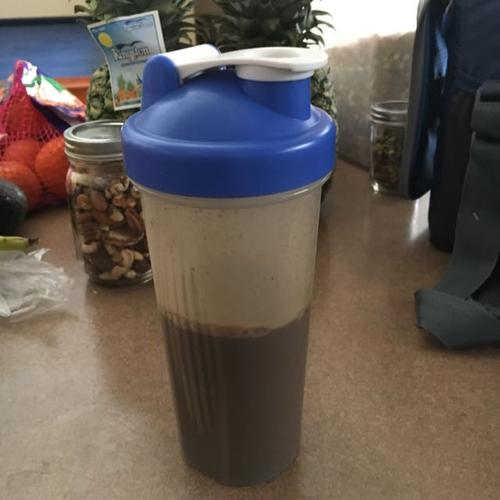


🔹 Response from Gemini (500px version):
{'grams': 400, 'name': 'Protein shake'}
{'grams': 50, 'name': 'Mixed nuts'}
{'grams': 200, 'name': 'Pineapple'}
{'grams': 100, 'name': 'Oranges'}

🔹 Response from Gemini (1000px version):
⚠️ No response for base64_1000.

 Processing Image 2/10 - image_29.png


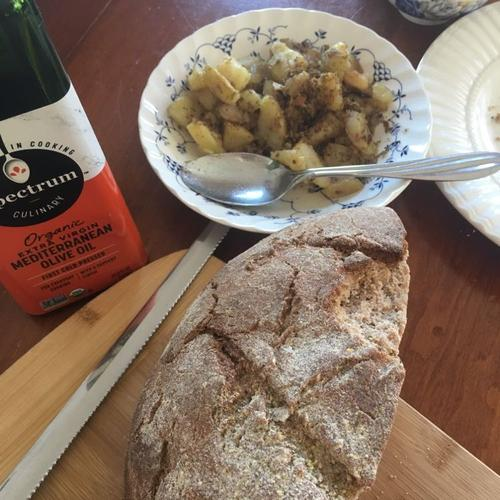


🔹 Response from Gemini (500px version):
{'grams': 200, 'name': 'Potatoes'}
{'grams': 350, 'name': 'Bread'}

🔹 Response from Gemini (1000px version):
{'grams': 200, 'name': 'Potatoes'}
{'grams': 500, 'name': 'Bread'}
{'grams': 50, 'name': 'Olive Oil'}

 Processing Image 3/10 - image_178.png


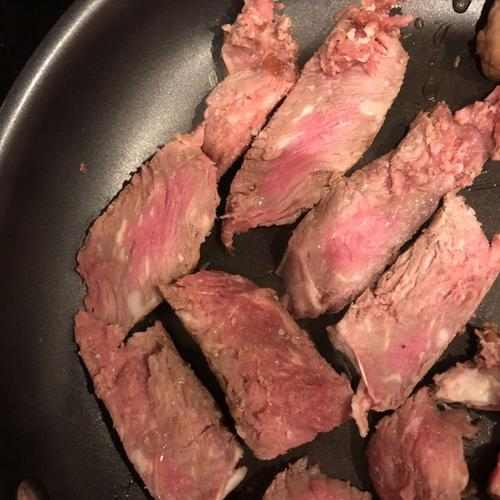


🔹 Response from Gemini (500px version):
{'grams': 200, 'name': 'Steak'}
{'grams': 150, 'name': 'Steak'}
{'grams': 120, 'name': 'Steak'}
{'grams': 100, 'name': 'Steak'}
{'grams': 80, 'name': 'Steak'}
{'grams': 70, 'name': 'Steak'}
{'grams': 60, 'name': 'Steak'}
{'grams': 50, 'name': 'Steak'}
{'grams': 40, 'name': 'Steak'}

🔹 Response from Gemini (1000px version):
⚠️ No response for base64_1000.

 Processing Image 4/10 - image_144.png


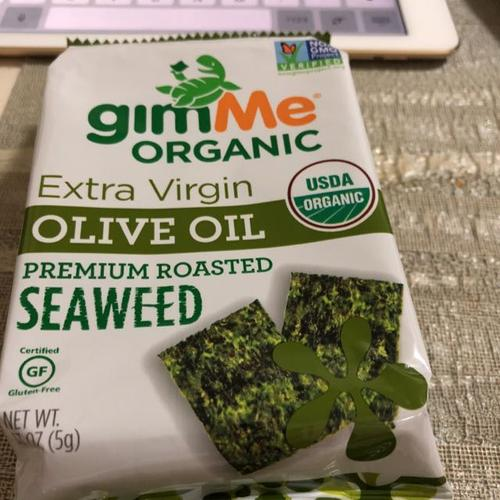


🔹 Response from Gemini (500px version):
 No response for base64_500.

🔹 Response from Gemini (1000px version):
⚠️ No response for base64_1000.

 Processing Image 5/10 - image_150.png


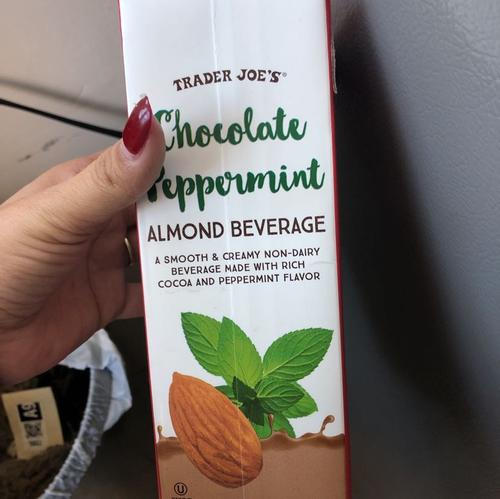


🔹 Response from Gemini (500px version):
{'grams': 946, 'name': "Trader Joe's Chocolate Peppermint Almond Beverage"}
{'grams': 10, 'name': 'almond'}
{'grams': 5, 'name': 'mint'}

🔹 Response from Gemini (1000px version):
{'grams': 946, 'name': 'Chocolate Peppermint Almond Beverage'}
{'grams': 10, 'name': 'Almond'}
{'grams': 5, 'name': 'Mint'}

 Processing Image 6/10 - image_187.png


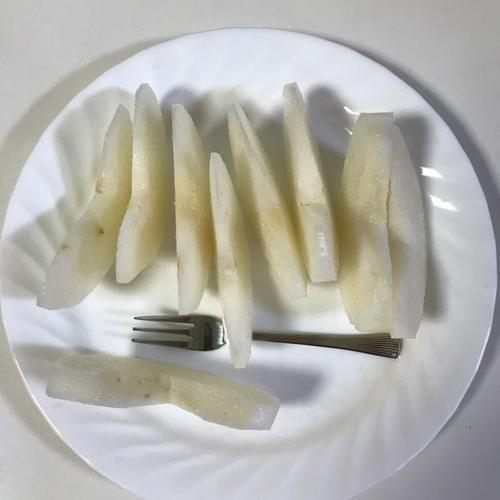


🔹 Response from Gemini (500px version):
 No response for base64_500.

🔹 Response from Gemini (1000px version):
⚠️ No response for base64_1000.

 Processing Image 7/10 - image_193.png


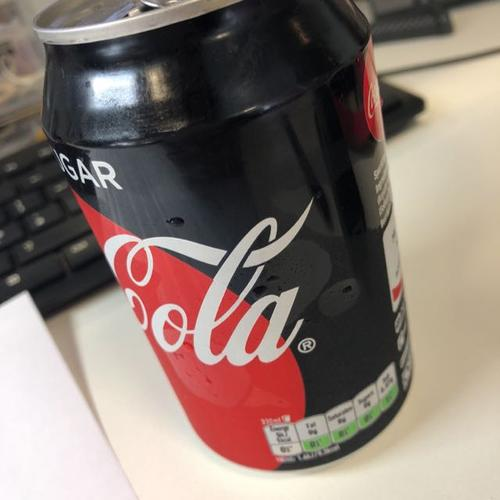


🔹 Response from Gemini (500px version):
{'grams': 330, 'name': 'Coca-Cola'}

🔹 Response from Gemini (1000px version):
{'grams': 330, 'name': 'Coca-Cola'}

 Processing Image 8/10 - image_226.png


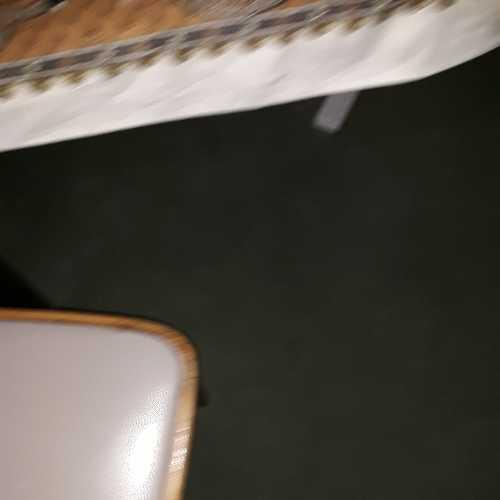


🔹 Response from Gemini (500px version):
 No response for base64_500.

🔹 Response from Gemini (1000px version):
⚠️ No response for base64_1000.

 Processing Image 9/10 - image_192.png


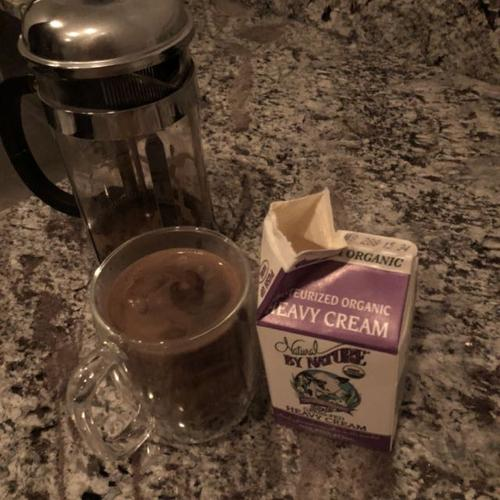


🔹 Response from Gemini (500px version):
{'grams': 200, 'name': 'Coffee'}
{'grams': 100, 'name': 'Heavy Cream'}

🔹 Response from Gemini (1000px version):
⚠️ No response for base64_1000.

 Processing Image 10/10 - image_186.png


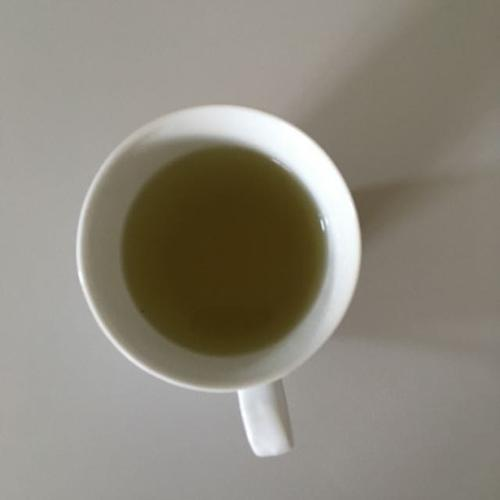


🔹 Response from Gemini (500px version):
 No response for base64_500.

🔹 Response from Gemini (1000px version):
⚠️ No response for base64_1000.


In [15]:
import base64
from IPython.display import display, Image as IPImage
from pprint import pprint
def display_base64_image(base64_string):
    try:
        image = IPImage(data=base64.b64decode(base64_string))
        display(image)
    except Exception as e:
        print(f"Error displaying image: {e}")
for index, row in df.iterrows():
    print(f"\n Processing Image {index+1}/{len(df)} - {row['file_name']}")
    if pd.notna(row['base64_500']):
        display_base64_image(row['base64_500'])
    else:
        print(" No Base64 image available for display.")
    print("\n🔹 Response from Gemini (500px version):")
    if isinstance(row['response_500'], list): 
        for item in row['response_500']:
            pprint(item)
    else:
        print(" No response for base64_500.")
    print("\n🔹 Response from Gemini (1000px version):")
    if isinstance(row['response_1000'], list):  
        for item in row['response_1000']:
            pprint(item)
    else:
        print("⚠️ No response for base64_1000.")


In [16]:
import re
def parse_amount(amount):
    try:
        number_pattern = r'\d+\.?\d*'
        unit_pattern = r'gram|g|ml|milliliters?|pieces?|piece'
        numbers = re.findall(number_pattern, amount.lower())
        units = re.findall(unit_pattern, amount.lower())
        if not numbers or not units:
            return None

        value = float(numbers[0])
        unit = units[0]
        if 'gram' in unit or 'g' in unit:
            return value  
        elif 'ml' in unit or 'milliliter' in unit:
            return value 
        elif 'piece' in unit:
            return 'pieces' 

        return None 
    except Exception as e:
        print(f"Error parsing amount '{amount}': {e}")
        return None

test_cases = [
    "approximately 200 grams",
    "250 ml",
    "1 piece",
    "3 pieces",
    "about 300 milliliters",
    "50 grams",
    "0.5 grams",
    "two pieces",  
    "one gram",   
    "1000mg",  
]

for test in test_cases:
    print(f"{test} -> {parse_amount(test)}")

approximately 200 grams -> 200.0
250 ml -> 250.0
1 piece -> pieces
3 pieces -> pieces
about 300 milliliters -> 300.0
50 grams -> 50.0
0.5 grams -> 0.5
two pieces -> None
one gram -> None
1000mg -> 1000.0


In [17]:
for i, row in enumerate(df['response_500']):
    print(f"\n Index: {i}")
    if isinstance(row, list):
        for item in row:
            if isinstance(item, dict) and 'grams' in item and item['grams'] > 0:
                print(f" {item['name']}: {item['grams']} g")
    else:
        print(" No valid data for this row.")


 Index: 0
 Protein shake: 400 g
 Mixed nuts: 50 g
 Pineapple: 200 g
 Oranges: 100 g

 Index: 1
 Potatoes: 200 g
 Bread: 350 g

 Index: 2
 Steak: 200 g
 Steak: 150 g
 Steak: 120 g
 Steak: 100 g
 Steak: 80 g
 Steak: 70 g
 Steak: 60 g
 Steak: 50 g
 Steak: 40 g

 Index: 3
 No valid data for this row.

 Index: 4
 Trader Joe's Chocolate Peppermint Almond Beverage: 946 g
 almond: 10 g
 mint: 5 g

 Index: 5
 No valid data for this row.

 Index: 6
 Coca-Cola: 330 g

 Index: 7
 No valid data for this row.

 Index: 8
 Coffee: 200 g
 Heavy Cream: 100 g

 Index: 9
 No valid data for this row.


Classifying if there is/are single/multiple food item and label /unlabeled

In [18]:
import pandas as pd
df['food_count'] = None  
df['has_label'] = None
for index, row in df.iterrows():
    try:
        if isinstance(row['response_500'], list):
            food_items = row['response_500']
            num_items = len(food_items)
            df.at[index, 'food_count'] = "Single" if num_items == 1 else "Multiple"
            has_label = any(
                any(keyword in item['name'].lower() for keyword in ["brand", "pack", "box", "container", "bottle", "can", "bag"])
                for item in food_items
            )
            df.at[index, 'has_label'] = "Labeled" if has_label else "Unlabeled"
        else:
            df.at[index, 'food_count'] = "Unknown"
            df.at[index, 'has_label'] = "Unknown"

    except Exception as e:
        print(f"⚠️ Error processing row {index}: {e}")
        df.at[index, 'food_count'] = "Error"
        df.at[index, 'has_label'] = "Error"
print(df[['file_name', 'food_count', 'has_label']].head(10)) 

       file_name food_count  has_label
0   image_15.png   Multiple  Unlabeled
1   image_29.png   Multiple  Unlabeled
2  image_178.png   Multiple  Unlabeled
3  image_144.png    Unknown    Unknown
4  image_150.png   Multiple  Unlabeled
5  image_187.png    Unknown    Unknown
6  image_193.png     Single  Unlabeled
7  image_226.png    Unknown    Unknown
8  image_192.png   Multiple  Unlabeled
9  image_186.png    Unknown    Unknown


Check with Gemini 


 Processing Image 1/10 - image_15.png


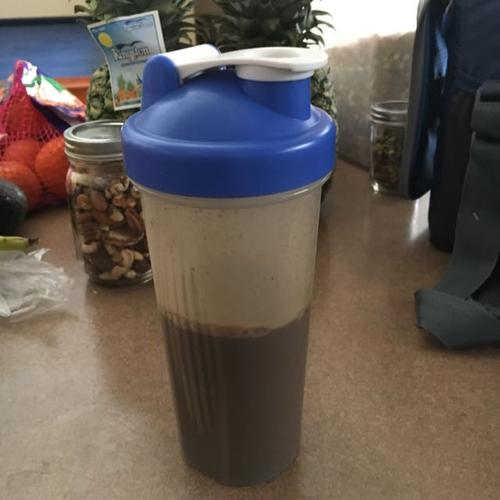

{'food_count': 'Single', 'has_label': 'Unlabeled'}

 Processing Image 2/10 - image_29.png


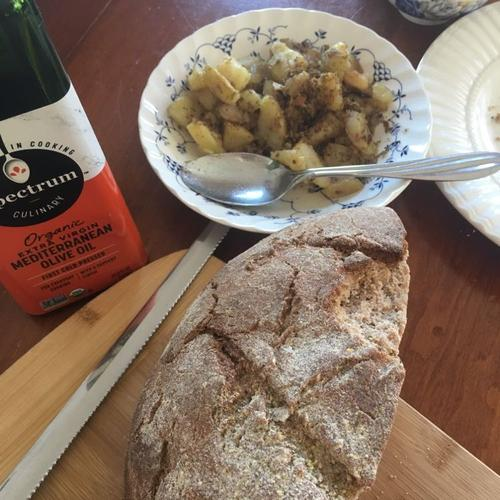

{'food_count': 'Multiple', 'has_label': 'Labeled'}

 Processing Image 3/10 - image_178.png


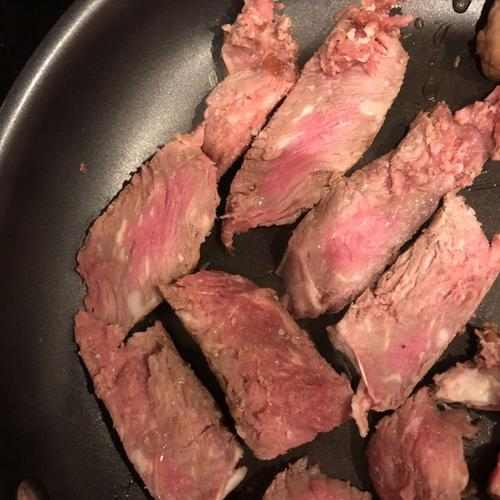

{'food_count': 'Multiple', 'has_label': 'Unlabeled'}

 Processing Image 4/10 - image_144.png


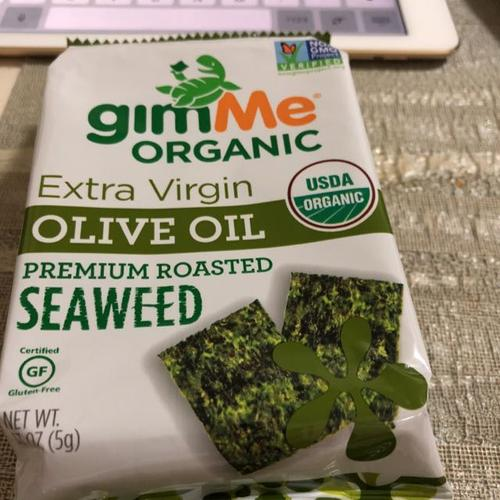

{'food_count': 'Multiple', 'has_label': 'Labeled'}

 Processing Image 5/10 - image_150.png


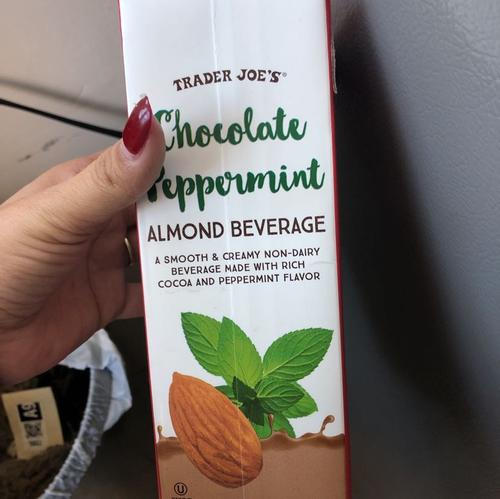

{'food_count': 'Single', 'has_label': 'Labeled'}

 Processing Image 6/10 - image_187.png


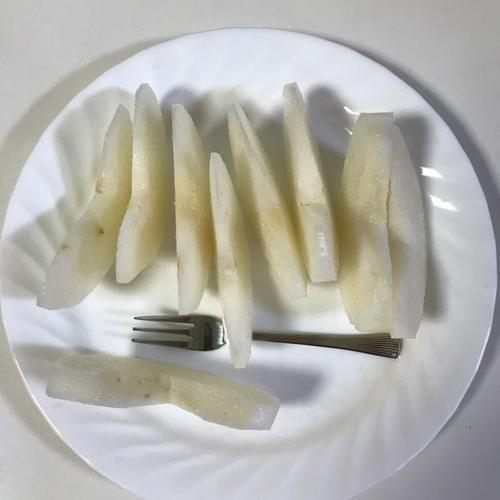

{'food_count': 'Multiple', 'has_label': 'Unlabeled'}

 Processing Image 7/10 - image_193.png


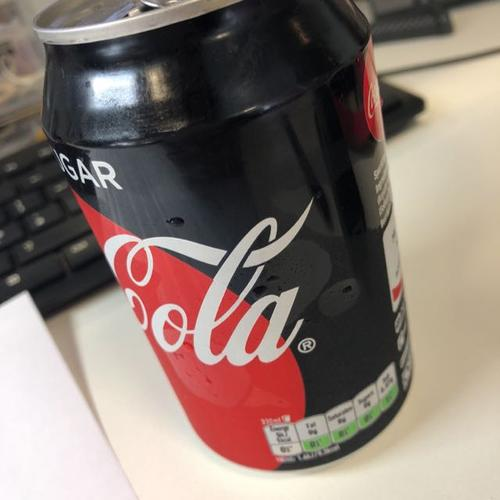

{'food_count': 'Single', 'has_label': 'Labeled'}

 Processing Image 8/10 - image_226.png


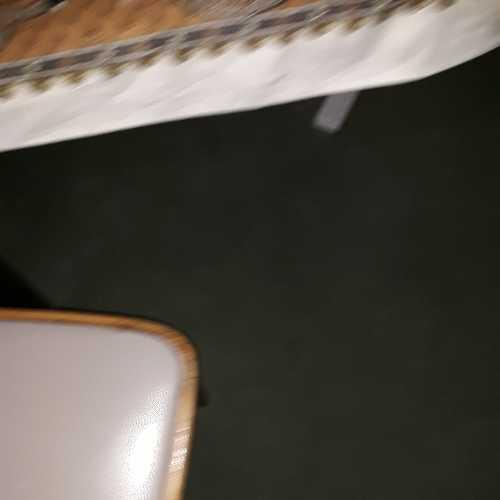

{'food_count': 'Multiple', 'has_label': 'Unlabeled'}

 Processing Image 9/10 - image_192.png


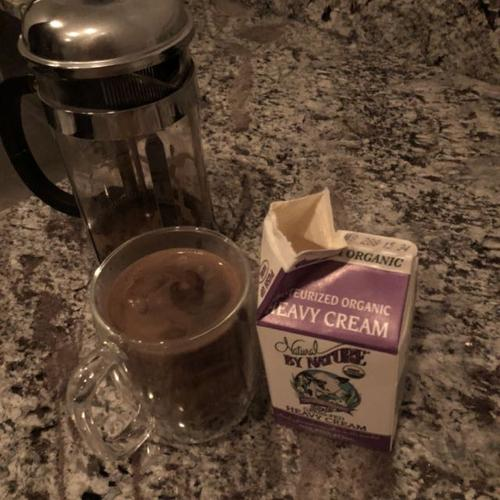

{'food_count': 'Multiple', 'has_label': 'Labeled'}

 Processing Image 10/10 - image_186.png


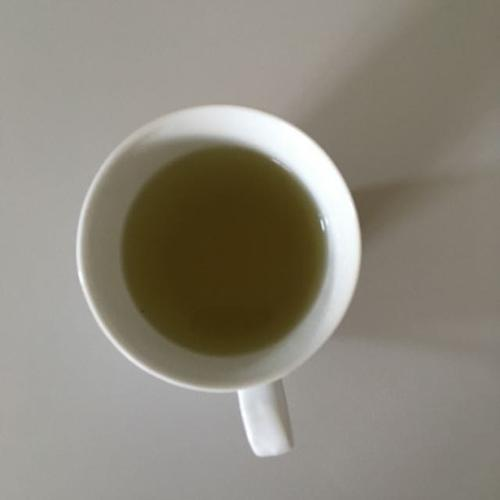

{'food_count': 'Single', 'has_label': 'Unlabeled'}

 Final Classification Results:
       file_name food_count  has_label
0   image_15.png     Single  Unlabeled
1   image_29.png   Multiple    Labeled
2  image_178.png   Multiple  Unlabeled
3  image_144.png   Multiple    Labeled
4  image_150.png     Single    Labeled
5  image_187.png   Multiple  Unlabeled
6  image_193.png     Single    Labeled
7  image_226.png   Multiple  Unlabeled
8  image_192.png   Multiple    Labeled
9  image_186.png     Single  Unlabeled


In [19]:
def classify_image_with_gemini(base64_image):
    model = genai.GenerativeModel("gemini-1.5-flash")
    contents = [
        {
            "parts": [
                {
                    "text": "Analyze the image and classify it into two categories: \n"
                            "**Single Food Item** OR **Multiple Food Items**\n"
                            "**Labeled (Has Brand/Text/Packaging)** OR **Unlabeled**\n"
                            "Respond in JSON format with keys:\n"
                            "- `food_count`: 'Single' or 'Multiple'\n"
                            "- `has_label`: 'Labeled' or 'Unlabeled'"
                },
                {
                    "inline_data": {
                        "mime_type": "image/png",
                        "data": base64_image
                    }
                }
            ]
        }
    ]

    try:
        # ✅ Send request to Gemini
        response = model.generate_content(contents=contents)

        # ✅ Extract and parse response
        if response and response.text:
            return json.loads(response.text.strip("```json").strip("```").strip())

    except Exception as e:
        print(f" Error classifying image: {e}")
        return {"food_count": "Unknown", "has_label": "Unknown"}
def display_base64_image(base64_string):
    try:
        image = IPImage(data=base64.b64decode(base64_string))
        display(image)
    except Exception as e:
        print(f" Error displaying image: {e}")
df['food_count'] = None
df['has_label'] = None
for index, row in df.iterrows():
    print(f"\n Processing Image {index+1}/{len(df)} - {row['file_name']}")
    if pd.notna(row['base64_500']):
        display_base64_image(row['base64_500'])
    else:
        print(" No Base64 image available for display.")
    classification = classify_image_with_gemini(row['base64_500'])
    df.at[index, 'food_count'] = classification.get('food_count', "Unknown")
    df.at[index, 'has_label'] = classification.get('has_label', "Unknown")
    pprint(classification)
print("\n Final Classification Results:")
print(df[['file_name', 'food_count', 'has_label']])


Thought process of the llm while processing the images 


 Processing Image 1/10 - image_15.png


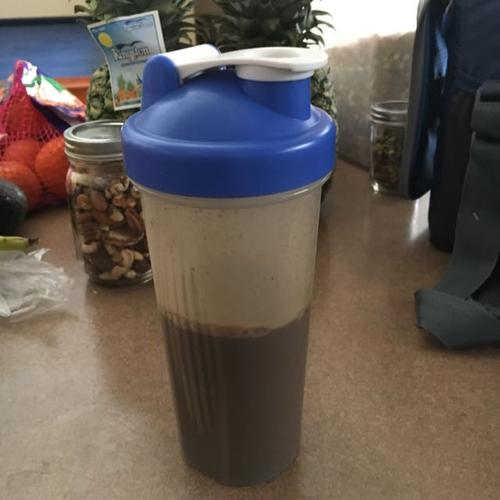


 Raw Model Response:
 json
{
  "reasoning": "Step 1: The image shows a single container with a blended substance inside.  There are other food items visible in the background, but they are not the primary focus and are not inside the container. Step 2: The container itself doesn't have any branding visible, it's a generic-looking shaker bottle.  Other food items such as nuts, fruits (mandarin oranges) are visible in the background but aren't individually labeled in the image. Step 3: Based on the analysis, there's only one item that is the focus, which is the blended food/drink inside the shaker cup. This container is unlabeled.",
  "classification": {
    "food_count": "Single",
    "has_label": "Unlabeled"
  }
}
```

 **Model's Reasoning:**
json
{
  "reasoning": "Step 1: The image shows a single container with a blended substance inside.  There are other food items visible in the background, but they are not the primary focus and are not inside the container. Step 2: The container i

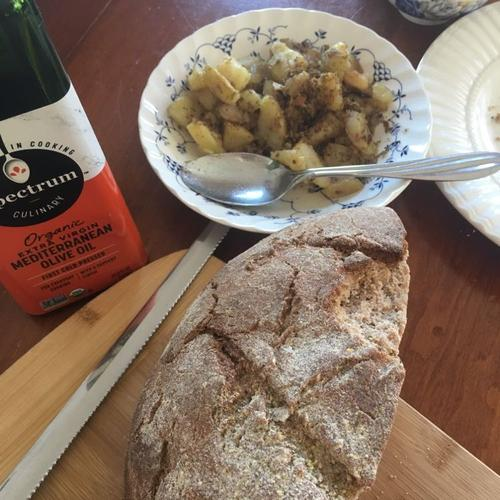


 Raw Model Response:
 json
{
  "reasoning": "Step 1: The image contains two distinct food items: a bowl of potatoes and a loaf of bread. \nStep 2:  The olive oil bottle has a label with branding and text. The food items themselves (potatoes and bread) do not have visible labels or branding. \nStep 3: Based on the observations, there are multiple food items present, but only one of them (the olive oil) has clear branding/labeling. The potatoes and bread are unlabeled.",
  "classification": {
    "food_count": "Multiple",
    "has_label": "Labeled"
  }
}
```

 **Model's Reasoning:**
json
{
  "reasoning": "Step 1: The image contains two distinct food items: a bowl of potatoes and a loaf of bread. \nStep 2:  The olive oil bottle has a label with branding and text. The food items themselves (potatoes and bread) do not have visible labels or branding. \nStep 3: Based on the observations, there are multiple food items present, but only one of them (the olive oil) has clear branding/labeling.

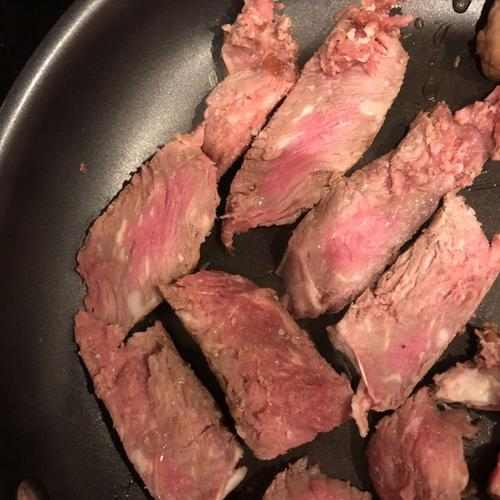


 Raw Model Response:
 json
{
  "reasoning": "Step 1: The image shows multiple pieces of sliced meat, all appearing to be the same type of food. \nStep 2: There is no visible text, branding, or packaging on the food items. The meat is simply shown in a pan. \nStep 3: Based on the steps above, the classification is determined as follows: Multiple food items (pieces of meat) and no labels are present.",
  "classification": {
    "food_count": "Multiple",
    "has_label": "Unlabeled"
  }
}
```

 **Model's Reasoning:**
json
{
  "reasoning": "Step 1: The image shows multiple pieces of sliced meat, all appearing to be the same type of food. \nStep 2: There is no visible text, branding, or packaging on the food items. The meat is simply shown in a pan. \nStep 3: Based on the steps above, the classification is determined as follows: Multiple food items (pieces of meat) and no labels are present.",
  "classification": {
    "food_count": "Multiple",
    "has_label": "Unlabeled"
  }
}
```
{'food

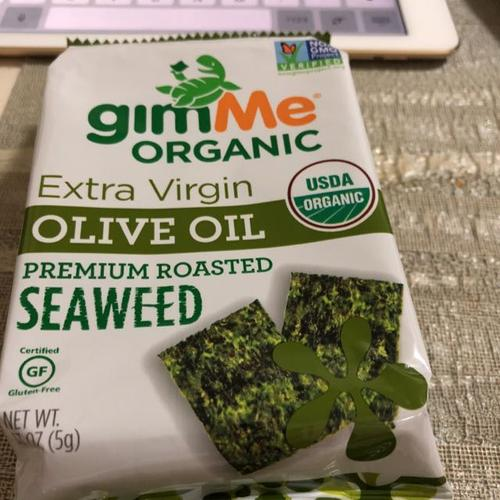


 Raw Model Response:
 json
{
  "reasoning": "Step 1: The image shows a single type of food item, which is a bag of roasted seaweed. \nStep 2: The food item has text and branding on its packaging.  The text indicates it's GimMe Organic Extra Virgin Olive Oil Premium Roasted Seaweed.  There are also various certifications displayed (USDA Organic, Gluten-Free). \nStep 3: Based on the presence of a single food item (seaweed) within a branded package and the significant amount of text labeling, the classification is a single labeled food item.",
  "classification": {
    "food_count": "Single",
    "has_label": "Labeled"
  }
}
```

 **Model's Reasoning:**
json
{
  "reasoning": "Step 1: The image shows a single type of food item, which is a bag of roasted seaweed. \nStep 2: The food item has text and branding on its packaging.  The text indicates it's GimMe Organic Extra Virgin Olive Oil Premium Roasted Seaweed.  There are also various certifications displayed (USDA Organic, Gluten-Free). \

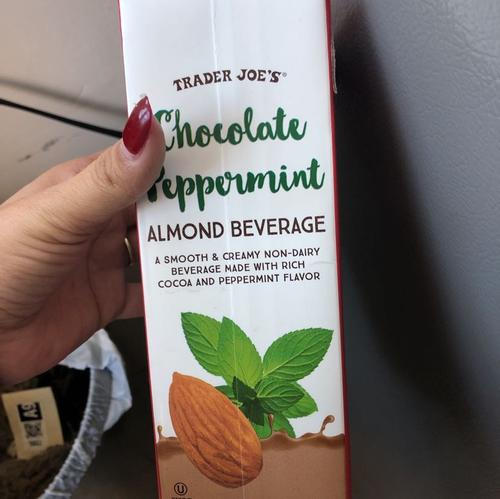


 Raw Model Response:
 json
{
  "reasoning": "Step 1: The image shows a carton of Trader Joe's Chocolate Peppermint Almond Beverage.  Only one type of food item is depicted.\nStep 2: The food item is clearly labeled with the brand name (Trader Joe's), product name (Chocolate Peppermint Almond Beverage), and a description of its ingredients and characteristics.\nStep 3: Based on the presence of a single food item and clear labeling on its packaging, the classification is as follows.",
  "classification": {
    "food_count": "Single",
    "has_label": "Labeled"
  }
}
```

 **Model's Reasoning:**
json
{
  "reasoning": "Step 1: The image shows a carton of Trader Joe's Chocolate Peppermint Almond Beverage.  Only one type of food item is depicted.\nStep 2: The food item is clearly labeled with the brand name (Trader Joe's), product name (Chocolate Peppermint Almond Beverage), and a description of its ingredients and characteristics.\nStep 3: Based on the presence of a single food item and cl

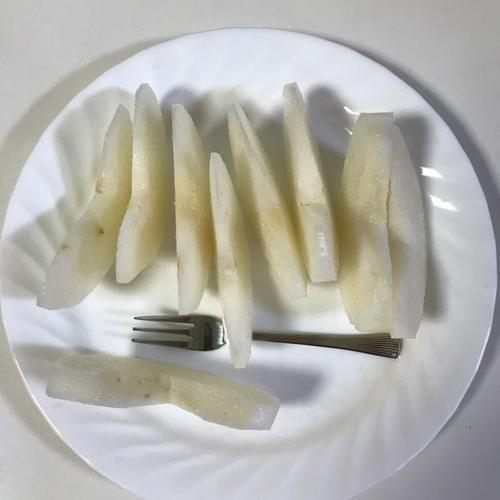


 Raw Model Response:
 json
{
  "reasoning": "Step 1: The image shows multiple pieces of what appears to be pear.  Step 2: There is no visible text, branding, or packaging on the food items.  Step 3: Based on the multiple pieces of fruit and the absence of labels, the classification is multiple unlabeled food items.",
  "classification": {
    "food_count": "Multiple",
    "has_label": "Unlabeled"
  }
}
```

 **Model's Reasoning:**
json
{
  "reasoning": "Step 1: The image shows multiple pieces of what appears to be pear.  Step 2: There is no visible text, branding, or packaging on the food items.  Step 3: Based on the multiple pieces of fruit and the absence of labels, the classification is multiple unlabeled food items.",
  "classification": {
    "food_count": "Multiple",
    "has_label": "Unlabeled"
  }
}
```
{'food_count': 'Unknown', 'has_label': 'Unknown'}

 Processing Image 7/10 - image_193.png


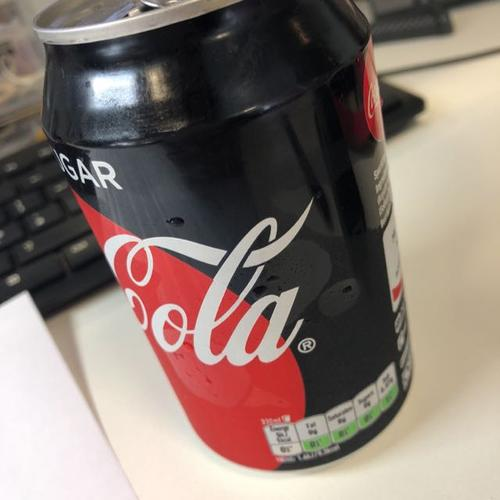


 Raw Model Response:
 json
{
  "reasoning": "Step 1: The image shows a single can of Coca-Cola. \nStep 2: The can has text and branding clearly visible, including the Coca-Cola logo and other nutritional information. \nStep 3: Based on the observation of only one food item present, and the presence of clear branding, the image is classified as a single, labeled food item.",
  "classification": {
    "food_count": "Single",
    "has_label": "Labeled"
  }
}
```

 **Model's Reasoning:**
json
{
  "reasoning": "Step 1: The image shows a single can of Coca-Cola. \nStep 2: The can has text and branding clearly visible, including the Coca-Cola logo and other nutritional information. \nStep 3: Based on the observation of only one food item present, and the presence of clear branding, the image is classified as a single, labeled food item.",
  "classification": {
    "food_count": "Single",
    "has_label": "Labeled"
  }
}
```
{'food_count': 'Unknown', 'has_label': 'Unknown'}

 Processing Image

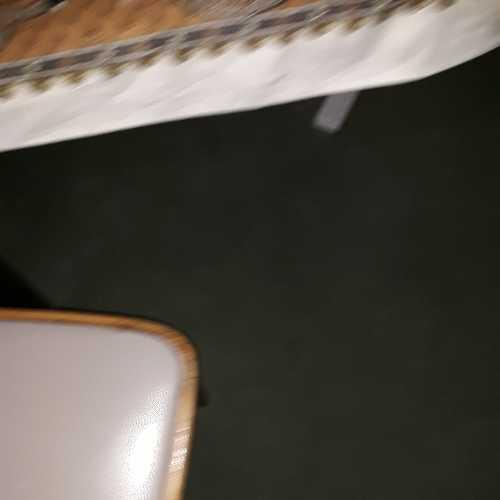


 Raw Model Response:
 json
{
  "reasoning": "Step 1: The image shows no food items.  Step 2: Consequently, there is no text, branding, or packaging related to food. Step 3: Based on the absence of any food items or related materials, the classification is that there is no food present in the image.",
  "classification": {
    "food_count": "Single",
    "has_label": "Unlabeled"
  }
}

 **Model's Reasoning:**
json
{
  "reasoning": "Step 1: The image shows no food items.  Step 2: Consequently, there is no text, branding, or packaging related to food. Step 3: Based on the absence of any food items or related materials, the classification is that there is no food present in the image.",
  "classification": {
    "food_count": "Single",
    "has_label": "Unlabeled"
  }
}
{'food_count': 'Unknown', 'has_label': 'Unknown'}

 Processing Image 9/10 - image_192.png


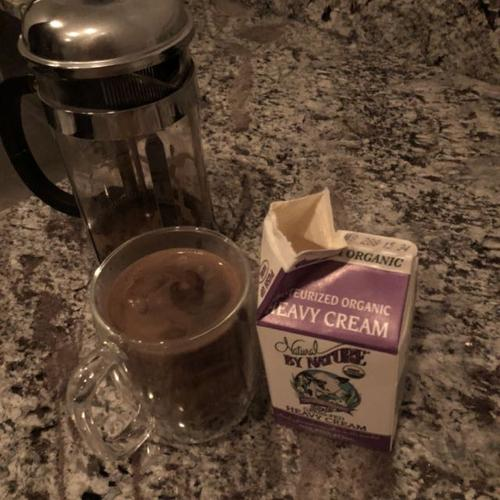


 Raw Model Response:
 json
{
  "reasoning": "Step 1: The image contains two distinct food items: a cup of coffee and a carton of heavy cream. \nStep 2: The carton of heavy cream has text and branding; it's labeled 'Natural By Nature' and specifies that it's pasteurized organic heavy cream. The coffee itself does not have a label.\nStep 3: Based on the above analysis, there are multiple food items, and at least one of the items is labeled.",
  "classification": {
    "food_count": "Multiple",
    "has_label": "Labeled"
  }
}
```

 **Model's Reasoning:**
json
{
  "reasoning": "Step 1: The image contains two distinct food items: a cup of coffee and a carton of heavy cream. \nStep 2: The carton of heavy cream has text and branding; it's labeled 'Natural By Nature' and specifies that it's pasteurized organic heavy cream. The coffee itself does not have a label.\nStep 3: Based on the above analysis, there are multiple food items, and at least one of the items is labeled.",
  "classification

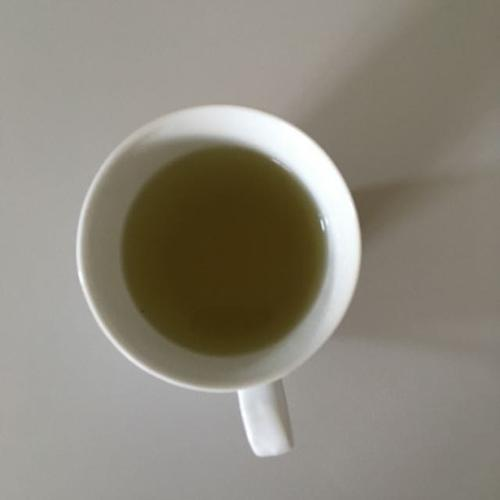


 Raw Model Response:
 json
{
  "reasoning": "Step 1: The image shows a single cup containing a liquid, presumably tea.  Step 2: There is no visible text, branding, or packaging on the cup or the liquid itself. Step 3: Based on the observation of a single food item (tea) without any labels, the classification is as follows.",
  "classification": {
    "food_count": "Single",
    "has_label": "Unlabeled"
  }
}
```

 **Model's Reasoning:**
json
{
  "reasoning": "Step 1: The image shows a single cup containing a liquid, presumably tea.  Step 2: There is no visible text, branding, or packaging on the cup or the liquid itself. Step 3: Based on the observation of a single food item (tea) without any labels, the classification is as follows.",
  "classification": {
    "food_count": "Single",
    "has_label": "Unlabeled"
  }
}
```
{'food_count': 'Unknown', 'has_label': 'Unknown'}

 Final Classification Results:
       file_name food_count has_label  \
0   image_15.png    Unknown   Unknown   


In [20]:
import base64
import google.generativeai as genai
import json
import pandas as pd
from IPython.display import display, Image as IPImage
from pprint import pprint

genai.configure(api_key=os.environ["GEMINI_API_KEY"])
def classify_image_with_reasoning(base64_image):
    model = genai.GenerativeModel("gemini-1.5-flash")

    contents = [
        {
            "parts": [
                {
                    "text": "Analyze the image step by step and explain your reasoning before classifying it.\n"
                            "1️ **First**, analyze the number of distinct food items present.\n"
                            "2️ **Second**, check if the food items have text, branding, or packaging.\n"
                            "3️ **Third**, narrate your reasoning process before finalizing the classification.\n"
                            "Respond in JSON format strictly:\n"
                            "{\n"
                            "  \"reasoning\": \"Step-by-step explanation\",\n"
                            "  \"classification\": {\n"
                            "    \"food_count\": \"Single\" or \"Multiple\",\n"
                            "    \"has_label\": \"Labeled\" or \"Unlabeled\"\n"
                            "  }\n"
                            "}\n"
                            "Ensure that the response is valid JSON and does not contain markdown formatting or extra characters."
                },
                {
                    "inline_data": {
                        "mime_type": "image/png",
                        "data": base64_image
                    }
                }
            ]
        }
    ]

    try:
        response = model.generate_content(contents=contents)

        if response and response.text:
            response_text = response.text.strip("```").strip()
            print("\n Raw Model Response:\n", response_text) 

            if "Classification:" in response_text:
                reasoning, classification_json = response_text.split("Classification:", 1)
                try:
                    fixed_json = classification_json.replace("'", "\"").strip()
                    classification = json.loads(fixed_json)
                except json.JSONDecodeError as e:
                    print(f" JSON Parsing Failed: {e}")
                    classification = {"food_count": "Unknown", "has_label": "Unknown"}
            else:
                reasoning = response_text
                classification = {"food_count": "Unknown", "has_label": "Unknown"}

            return reasoning.strip(), classification

        else:
            print(" Error: No valid response received.")
            return "Error in reasoning", {"food_count": "Unknown", "has_label": "Unknown"}

    except Exception as e:
        print(f" Error classifying image: {e}")
        return "Error in reasoning", {"food_count": "Unknown", "has_label": "Unknown"}


def display_base64_image(base64_string):
    try:
        image = IPImage(data=base64.b64decode(base64_string))
        display(image)
    except Exception as e:
        print(f" Error displaying image: {e}")


df['food_count'] = None
df['has_label'] = None
df['reasoning'] = None  


for index, row in df.iterrows():
    print(f"\n Processing Image {index+1}/{len(df)} - {row['file_name']}")

   
    if pd.notna(row['base64_500']):
        display_base64_image(row['base64_500'])
    else:
        print("No Base64 image available for display.")
    reasoning, classification = classify_image_with_reasoning(row['base64_500'])
    df.at[index, 'food_count'] = classification.get('food_count', "Unknown")
    df.at[index, 'has_label'] = classification.get('has_label', "Unknown")
    df.at[index, 'reasoning'] = reasoning
    print("\n **Model's Reasoning:**")
    print(reasoning)
    pprint(classification)
print("\n Final Classification Results:")
print(df[['file_name', 'food_count', 'has_label', 'reasoning']])


In [21]:
print(response_text)

[
  {
    "name": "Trader Joe's Chocolate Peppermint Almond Beverage",
    "grams": 946,
    "bounding_box": [
      0,
      0,
      666,
      999
    ]
  }
]


Gemini after incremental thinking 


 **Processing Image 1/10 - image_15.png**


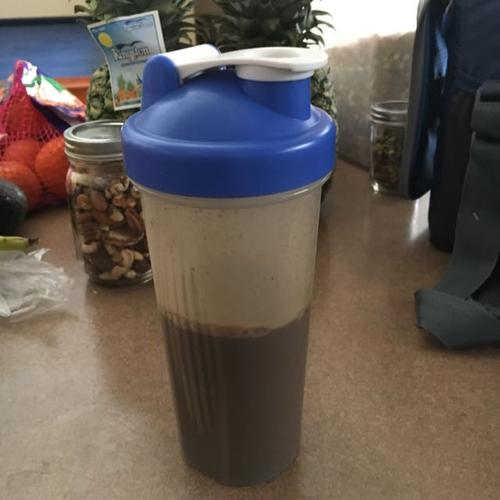


 **Model's Initial Thinking (Before Food Analysis):**
Step 1: The image shows one primary food item: a blended drink in a shaker bottle.  There are secondary food items visible in the background such as nuts in a jar and some fruit, but these are not the focus.

Step 2:  There is no visible branding or label on the shaker bottle containing the blended drink. The background shows a bag of fruit (possibly oranges), a jar of nuts, and a partially visible package of something else.  There is a brand label on one of the fruit packages. 

Step 3: The main focus is a single food item; a blended drink. Although other foods are present, they aren't the primary subject of the image. The presence of other foods doesn't change that the primary visible item is a single drink, so only considering the primary item is the most appropriate choice.  The drink itself is unlabeled, though a label is visible on other items.

 **Response from Gemini (500px version):**
{'grams': 500, 'name': 'Oranges'}
{'gr

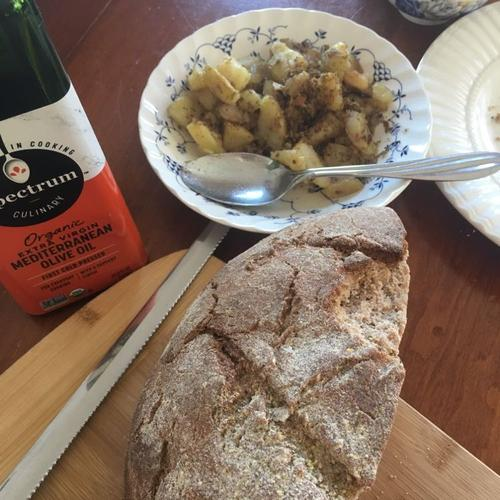


 **Model's Initial Thinking (Before Food Analysis):**
Step 1: The image shows two distinct food items: a bowl of seasoned potatoes and a loaf of bread.

Step 2: A bottle of Spectrum Culinary Organic Extra Virgin Mediterranean Olive Oil is visible in the background.  The food items themselves lack labels or clear brand identification.

Step 3:  There are two separate food items presented, not a single dish.  The olive oil bottle is likely relevant to the preparation of the potatoes, but it's not directly part of the food being presented.  The presence of the olive oil bottle suggests some level of intentionality in the presentation, implying a planned meal rather than random items.

Therefore, while there's a clear distinction between the potatoes and the bread, and the presence of the olive oil bottle is noteworthy, the focus is on the two food items being the main components.

 **Response from Gemini (500px version):**
{'grams': 400, 'name': 'Bread'}
{'grams': 250, 'name': 'Potatoes'

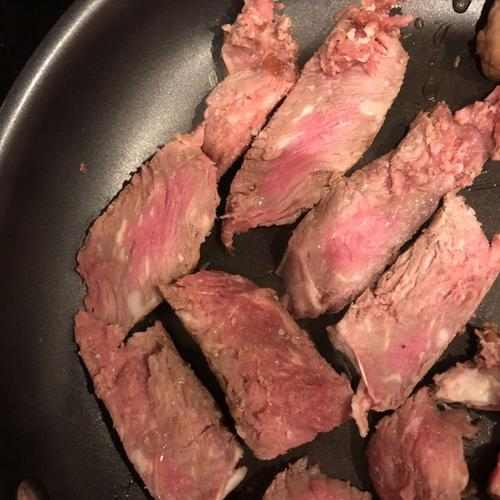


 **Model's Initial Thinking (Before Food Analysis):**
Step 1: The image shows multiple pieces of what appears to be sliced beef in a frying pan.  I can visually distinguish at least eight to ten separate pieces, though some are overlapping and difficult to definitively count.

Step 2: There are no visible brand names, labels, or packaging present in the image. The food is just in a pan.

Step 3: Based on the visual observation, there are multiple pieces of meat. They are uncooked or partially cooked.  The lack of any packaging or labels makes it impossible to identify a specific brand or type of meat beyond a general classification as beef.  Therefore, my final conclusion is that there are multiple unlabeled pieces of what appears to be beef.

 **Response from Gemini (500px version):**
{'grams': 250, 'name': 'Beef'}

 **Response from Gemini (1000px version):**
{'grams': 250, 'name': 'Beef'}

 **Final Model's Reasoning (After Food Analysis):**
Step 1: The image shows multiple pieces of

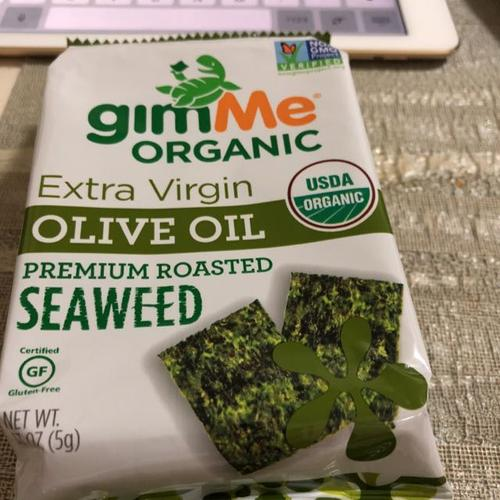


 **Model's Initial Thinking (Before Food Analysis):**
Step 1: The image shows a single food item: a bag of seaweed snacks.
Step 2: The bag is clearly labeled with the brand name 'gimMe ORGANIC', indicating it's a commercially produced product.  The label also specifies 'Extra Virgin Olive Oil Premium Roasted Seaweed', 'USDA Organic', and 'Gluten Free'.
Step 3: Based on the clearly visible branding, packaging, and product description on the bag, it's evident that the image depicts a single, labeled food item - a bag of seaweed snacks.

 **Response from Gemini (500px version):**
{'grams': 5, 'name': 'Seaweed'}

 **Response from Gemini (1000px version):**
{'grams': 5, 'name': 'Seaweed'}

 **Final Model's Reasoning (After Food Analysis):**
Step 1: The image shows a single food item, a bag of seaweed snacks.
Step 2: The bag is clearly labeled with the brand name "gimMe Organic,"  product description ("Extra Virgin Olive Oil Premium Roasted Seaweed"), weight, and several certifications (USD

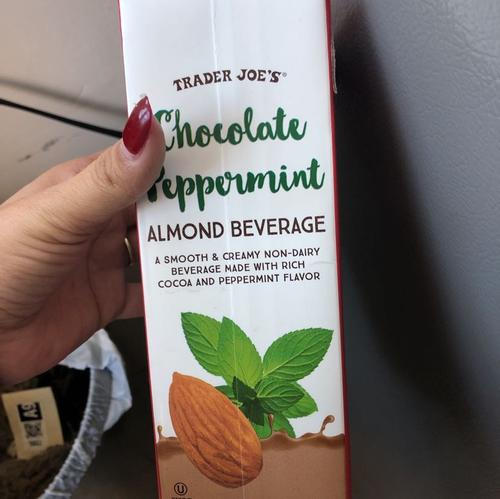


 **Model's Initial Thinking (Before Food Analysis):**
Step 1: The image shows a single carton of Trader Joe's Chocolate Peppermint Almond Beverage.  There are no other distinct food items visible.
Step 2: The carton has a clear label with the Trader Joe's branding and descriptive text detailing the product (Chocolate Peppermint Almond Beverage). It also includes ingredients and other relevant information.
Step 3: Based on the image, there's only one identifiable food item: the carton of almond beverage. The label provides additional details which confirms that the image depicts a single food item, and that it is labeled. There is no ambiguity about it being one item.

 **Response from Gemini (500px version):**
{'grams': 960, 'name': 'Chocolate Peppermint Almond Beverage'}
{'grams': 1, 'name': 'Almond'}

 **Response from Gemini (1000px version):**
{'grams': 946, 'name': 'Chocolate Peppermint Almond Beverage'}
{'grams': 1, 'name': 'Almond'}

 **Final Model's Reasoning (After Food Analys

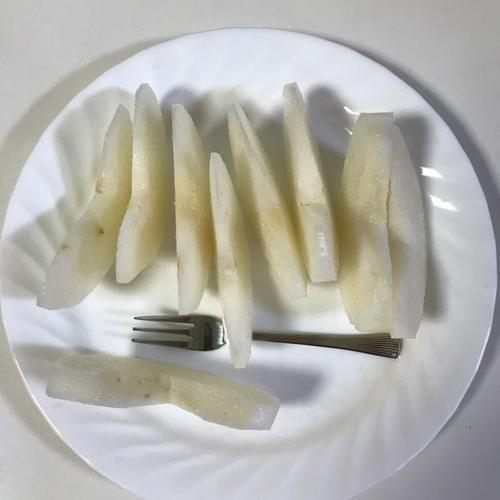


 **Model's Initial Thinking (Before Food Analysis):**
Step 1: The image shows multiple pieces of what appears to be sliced pear.  There are seven larger pieces arranged in a row and two smaller pieces placed separately below the row.  Therefore, there are a total of nine distinct food items visible. 

Step 2: There are no visible brands, labels, or packaging in the image. The pear slices appear to be fresh and unprocessed. 

Step 3: Based on the visual characteristics, I can deduce the food item to be sliced pears. The uniform slices and creamy white color with a slightly translucent quality are consistent with the appearance of pear fruit. The absence of any packaging or branding suggests it is a simple, unprocessed food. Thus, the final decision will be consistent with a food that appears to be fresh pear slices.

 **Response from Gemini (500px version):**
{'grams': 150, 'name': 'Pear slices'}

 **Response from Gemini (1000px version):**
{'grams': 150, 'name': 'Pear slices'}

 **Fin

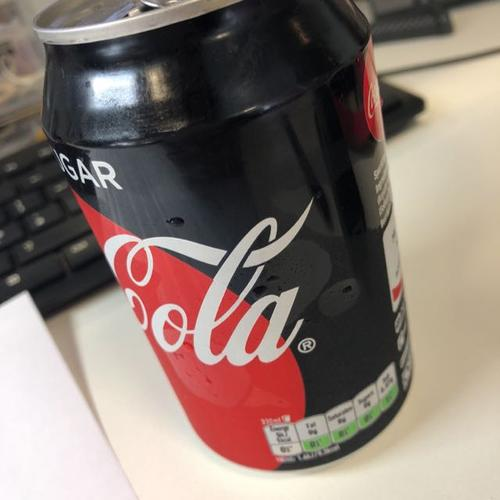


 **Model's Initial Thinking (Before Food Analysis):**
Step 1: The image shows a single can of beverage.
Step 2: The can is clearly labeled with the Coca-Cola branding and other information, including nutritional facts.
Step 3: Based on the visible Coca-Cola logo and packaging, it's evident that the item is a commercially produced and labeled soft drink.  There's only one item present in the image, a can of Coca-Cola.

 **Response from Gemini (500px version):**
{'grams': 330, 'name': 'Coca Cola Zero'}

 **Response from Gemini (1000px version):**
{'grams': 330, 'name': 'Coca Cola Zero'}

 **Final Model's Reasoning (After Food Analysis):**
Step 1: The image shows a single food item, a can of Coca-Cola. 
Step 2: The can is clearly labeled with the Coca-Cola brand and other nutritional information. 
Step 3: Based on the clear labeling and the visual of a single can of soda, there is only one food item present. The label identifies the brand and product type clearly. Therefore, the analysis

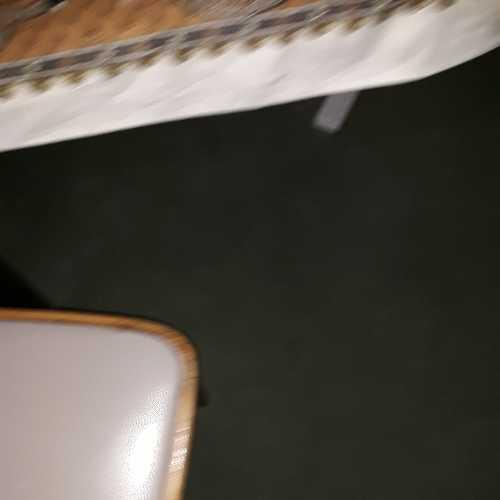


 **Model's Initial Thinking (Before Food Analysis):**
Step 1: The image shows no food items.  The main focus is on a piece of furniture (a table or chair) and a portion of what appears to be a wall or carpet.

Step 2: There are no brands, labels, or packaging visible in the image.

Step 3: Based on the lack of any food items, edibles, or related packaging, I conclude that the image contains no food. The image is blurry and the focus is not on any food-related object.

 **Response from Gemini (500px version):**

 **Response from Gemini (1000px version):**

 **Final Model's Reasoning (After Food Analysis):**
Step 1: The image shows no food items. Only a portion of a chair and a blurry object above it are visible. 
Step 2: There are no visible brands, labels, or packaging related to food.
Step 3: Based on the lack of any food items in the image, it's impossible to estimate any food-related aspects.  The image is dominated by a dark background, a portion of what appears to be a light-colo

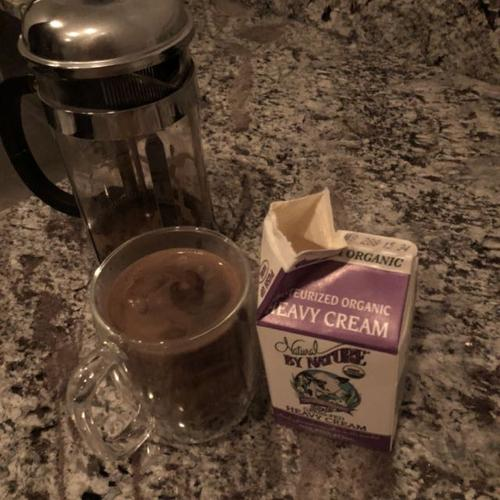


 **Model's Initial Thinking (Before Food Analysis):**
Step 1: The image contains two distinct food items: a cup of coffee and a carton of heavy cream.

Step 2: The carton of heavy cream has a label with branding and information, including the brand name "Natural By Nature" and details such as "Pasteurized Organic Heavy Cream".

Step 3:  Based on visual inspection, there are clearly two separate food items. One is a beverage (coffee), and the other is a dairy product (heavy cream). The cream is packaged and labeled, whereas the coffee is in a glass mug.  There is no ambiguity in identifying the items as distinct and separate.

 **Response from Gemini (500px version):**
{'grams': 300, 'name': 'Coffee'}
{'grams': 50, 'name': 'Heavy Cream'}

 **Response from Gemini (1000px version):**
{'grams': 240, 'name': 'Coffee'}
{'grams': 50, 'name': 'Heavy Cream'}

 **Final Model's Reasoning (After Food Analysis):**
Step 1: I see two distinct food items in the image: a mug containing a dark liquid (

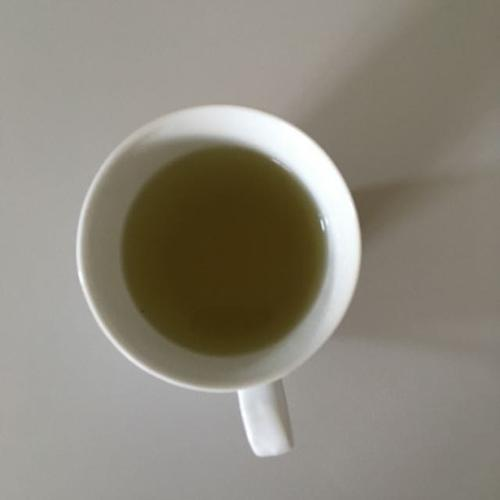


 **Model's Initial Thinking (Before Food Analysis):**
Step 1: The image shows a single cup containing a liquid, presumably tea.  There are no other distinct food items visible.
Step 2: There is no visible branding, label, or packaging on the cup or the liquid inside.
Step 3: Based on the image, only one food item, a beverage, is present.  The lack of any branding or labels makes it impossible to identify the specific type of tea or beverage. The image only provides visual information about a single cup of liquid.

 **Response from Gemini (500px version):**
{'grams': 240, 'name': 'Green Tea'}

 **Response from Gemini (1000px version):**
{'grams': 240, 'name': 'Green Tea'}

 **Final Model's Reasoning (After Food Analysis):**
Step 1: The image shows a single cup containing a liquid, presumably tea. There are no other distinct food items visible.
Step 2: There is no branding, label, or packaging visible on the cup or its contents.
Step 3: Based on the visual, only one food item is present

In [ ]:
import base64
import google.generativeai as genai
import json
import pandas as pd
from IPython.display import display, Image as IPImage
from pprint import pprint
genai.configure(api_key=os.environ["GEMINI_API_KEY"])
def get_food_estimates_from_image(base64_image):
    model = genai.GenerativeModel("gemini-2.0-flash")

    contents = [
        {
            "parts": [
                {
                    "text": "Identify all food or drink items in the image and estimate their quantity in grams."# convert both into the same prompyt 
                            "Respond **only** in JSON format with fields: 'name' and 'grams'."
                            "Ensure valid JSON output **without markdown, text explanations, or extra characters**."
                },
                {
                    "inline_data": {
                        "mime_type": "image/png",
                        "data": base64_image
                    }
                }
            ]
        }
    ]

    try:
        response = model.generate_content(contents=contents)
        if response and response.text:
            response_text = response.text.strip().strip("```json").strip("```").strip()
            return json.loads(response_text) if response_text else []
        else:
            print("⚠️ Error: No valid response received.")
            return []
    except json.JSONDecodeError as e:
        print(f" JSON Parsing Failed for Food Estimates: {e}")
        return []
    except Exception as e:
        print(f" Error processing image for food estimates: {e}")
        return []
def classify_image_with_reasoning(base64_image):
    model = genai.GenerativeModel("gemini-2.0-flash")

    prompt_text = (
        "Analyze the image step by step **before seeing the food estimates** and explain your reasoning.\n"#give background info as well 
        "1️ **Step 1:** Count distinct food items in the image.\n"#multiple food types
        "2️ **Step 2:** Check for branding, labels, or packaging.\n"
        "3️ **Step 3:** Explain your thought process **before making a final decision**.\n"
        " **Now, respond strictly in this JSON format:**\n"
        "{\n"
        "  \"reasoning\": \"Step-by-step breakdown\",\n"
        "  \"classification\": {\n"
        "    \"food_count\": \"Single\" or \"Multiple\",\n"
        "    \"has_label\": \"Labeled\" or \"Unlabeled\"\n"
        "  }\n"
        "}\n"
        " **Ensure correct JSON formatting without markdown artifacts!**"
    )

    contents = [
        {
            "parts": [
                {"text": prompt_text},
                {"inline_data": {"mime_type": "image/png", "data": base64_image}}
            ]
        }
    ]

    try:
        response = model.generate_content(contents=contents)
        if response and response.text:
            response_text = response.text.strip().strip("```json").strip("```").strip()
            return json.loads(response_text)
        else:
            print(" Error: No valid response received.")
            return {"reasoning": "Error in reasoning", "classification": {"food_count": "Unknown", "has_label": "Unknown"}}

    except json.JSONDecodeError as e:
        print(f" JSON Parsing Failed for Classification: {e}")
        return {"reasoning": "Error parsing reasoning.", "classification": {"food_count": "Unknown", "has_label": "Unknown"}}
    except Exception as e:
        print(f" Error classifying image: {e}")
        return {"reasoning": "Error in reasoning", "classification": {"food_count": "Unknown", "has_label": "Unknown"}}

def display_base64_image(base64_string):
    try:
        image = IPImage(data=base64.b64decode(base64_string))
        display(image)
    except Exception as e:
        print(f" Error displaying image: {e}")

df['food_count'] = None
df['has_label'] = None
df['reasoning'] = None

for index, row in df.iterrows():
    print(f"\n **Processing Image {index+1}/{len(df)} - {row['file_name']}**")

    if pd.notna(row['base64_500']):
        display_base64_image(row['base64_500'])
    else:
        print(" No Base64 image available for display.")

    initial_response = classify_image_with_reasoning(row['base64_500'])
    reasoning = initial_response.get("reasoning", "Error in reasoning")
    classification = initial_response.get("classification", {"food_count": "Unknown", "has_label": "Unknown"})

    print("\n **Model's Initial Thinking (Before Food Analysis):**")
    print(reasoning)

    print("\n **Response from Gemini (500px version):**")
    response_500 = get_food_estimates_from_image(row['base64_500'])
    if isinstance(response_500, list):
        for item in response_500:
            pprint(item)
    else:
        print(" No response for base64_500.")

    print("\n **Response from Gemini (1000px version):**")
    response_1000 = get_food_estimates_from_image(row['base64_1000'])
    if isinstance(response_1000, list):
        for item in response_1000:
            pprint(item)
    else:
        print(" No response for base64_1000.")
    all_food_items = (response_500 if isinstance(response_500, list) else []) + \
                     (response_1000 if isinstance(response_1000, list) else [])
    
    food_estimates_text = json.dumps(all_food_items, indent=2)
    final_response = classify_image_with_reasoning(row['base64_500'])
    final_reasoning = final_response.get("reasoning", "Error in final reasoning")
    final_classification = final_response.get("classification", {"food_count": "Unknown", "has_label": "Unknown"})
    df.at[index, 'food_count'] = final_classification.get('food_count', "Unknown")
    df.at[index, 'has_label'] = final_classification.get('has_label', "Unknown")
    df.at[index, 'reasoning'] = final_reasoning

    print("\n **Final Model's Reasoning (After Food Analysis):**")
    print(final_reasoning)
    pprint(final_classification)

print("\n **Final Classification Results:**")
print(df[['file_name', 'food_count', 'has_label', 'reasoning']])

Comparing with and without incremental thinking 